# Final Exam Part B   
Student Name: <strong>Parthasarathy Rajendiran</strong> <br>
Student ID: <strong>8883828</strong>
<hr>

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly
import plotly.express as px

sns.set_theme()
%matplotlib inline

plotly.offline.init_notebook_mode()

In [2]:
from sklearn.model_selection import cross_val_score, cross_validate, train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier, AdaBoostClassifier
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report

In [3]:
import warnings
warnings.filterwarnings('ignore')

#### Loading Datasets

In [4]:
src_folder = '../../practical_labs/datasets/final_exam_part_b_dataset/'
#
X_train = pd.read_csv(src_folder + 'x_train.csv')
y_train = pd.read_csv(src_folder + 'y_train.csv')

X_test = pd.read_csv(src_folder + 'x_test.csv')
y_test = pd.read_csv(src_folder + 'y_test.csv')

print(f'The data is splitted into train set with {X_train.shape[0]} records and test set with  {X_test.shape[0]}')

The data is splitted into train set with 60000 records and test set with  10000


In [5]:
X_train

,0,1,2,3,4,5,6,7,8,9,...,774,775,776,777,778,779,780,781,782,783
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,1,0,0,0,0,...,119,114,130,76,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,22,...,0,0,1,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,33,96,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59995,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
59996,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
59997,0,0,0,0,0,0,0,0,0,5,...,0,0,0,0,0,0,0,0,0,0
59998,0,0,0,0,0,0,0,0,0,0,...,66,54,50,5,0,1,0,0,0,0


In [26]:
print(type(y_train), y_train.shape)

<class 'pandas.core.series.Series'> (60000,)


In [7]:
y_train.value_counts()

0
4    18000
0    12000
2    12000
3    12000
1     6000
Name: count, dtype: int64

In [8]:
y_train = y_train.iloc[:,0]
y_test = y_test.iloc[:,0]

### Baseline Model

`DecisionTreeClassifier` has been chosen as a shallow classifier for this task.  
Because Decision tree doesn't generate complex decision boundaries. A decision tree with depth=3 is a simple classification model and can be benefitted when used with ensemble models.

In [9]:
base_model = DecisionTreeClassifier(max_depth=3)

In [10]:
cv_scores_base = cross_validate(base_model, X_train, y_train, cv=5,
                        scoring='accuracy',
                        return_train_score=True)

In [11]:
cv_scores_base

{'fit_time': array([2.6920588 , 2.55660701, 2.57850957, 2.52272201, 2.51720119]),
 'score_time': array([0.01388454, 0.01375318, 0.01139665, 0.0130074 , 0.01335025]),
 'test_score': array([0.68891667, 0.69041667, 0.69233333, 0.69075   , 0.68716667]),
 'train_score': array([0.6939375 , 0.69297917, 0.69295833, 0.69329167, 0.68822917])}

In [12]:
print(f'Accuracy of Decision Tree Classifier (base_model): {cv_scores_base["train_score"].mean():.4f}')

Accuracy of Decision Tree Classifier (base_model): 0.6923


### Bagging

In [13]:
bagging_model = BaggingClassifier(estimator=base_model, n_estimators=10, random_state=8883828)

In [14]:
cv_scores_bagging = cross_validate(bagging_model, X_train, y_train, cv=5,
                        scoring='accuracy',
                        return_train_score=True)

In [15]:
cv_scores_bagging

{'fit_time': array([17.0440886 , 16.95176435, 17.11475921, 16.93147206, 17.0498209 ]),
 'score_time': array([0.28817677, 0.23273516, 0.28670883, 0.25552917, 0.24111319]),
 'test_score': array([0.69683333, 0.69975   , 0.7005    , 0.69575   , 0.69991667]),
 'train_score': array([0.7019375 , 0.70120833, 0.702     , 0.69741667, 0.700125  ])}

In [16]:
print(f'Accuracy of Bagging classifier: {cv_scores_bagging["train_score"].mean():.4f}')


Accuracy of Bagging classifier: 0.7005


### Boosting

In [17]:
boosting_model = AdaBoostClassifier(estimator=base_model, n_estimators=10, random_state=8883828)

In [18]:
cv_scores_boosting = cross_validate(boosting_model, X_train, y_train, cv=5,
                        scoring='accuracy',
                        return_train_score=True)

In [19]:
cv_scores_boosting

{'fit_time': array([26.45420384, 26.27895164, 26.17591429, 26.362499  , 25.99204803]),
 'score_time': array([0.11121011, 0.13564491, 0.11562133, 0.11425638, 0.11182547]),
 'test_score': array([0.66425   , 0.73308333, 0.72925   , 0.71116667, 0.68233333]),
 'train_score': array([0.66014583, 0.73635417, 0.72372917, 0.71441667, 0.68154167])}

In [20]:
print(f'Accuracy of Boosting classifier: {cv_scores_boosting["train_score"].mean():.4f}')

Accuracy of Boosting classifier: 0.7032


### Validating the models with Test set

#### Fitting the models

In [21]:
base_model.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=3)

In [22]:
bagging_model.fit(X_train, y_train)

BaggingClassifier(estimator=DecisionTreeClassifier(max_depth=3),
                  random_state=8883828)

In [23]:
boosting_model.fit(X_train, y_train)

AdaBoostClassifier(estimator=DecisionTreeClassifier(max_depth=3),
                   n_estimators=10, random_state=8883828)

#### Inferring the models for Test dataset

In [24]:
y_pred_base = base_model.predict(X_test)
y_pred_bagging = bagging_model.predict(X_test)
y_pred_boosting = boosting_model.predict(X_test)

In [29]:
def show_metrics(y_true, y_pred, classes, title='Confusion Matrix'):
    conf_mat = confusion_matrix(y_true, y_pred)
    disp = ConfusionMatrixDisplay(confusion_matrix=conf_mat, display_labels=classes)
    disp.plot()
    plt.grid(False)
    plt.title(title)
    plt.show()
    print(classification_report(y_true, y_pred))

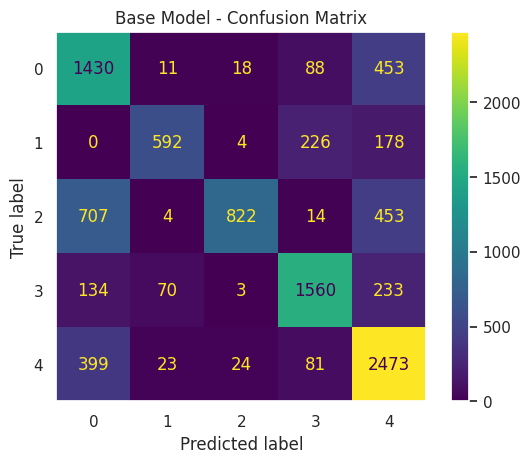

              precision    recall  f1-score   support

           0       0.54      0.71      0.61      2000
           1       0.85      0.59      0.70      1000
           2       0.94      0.41      0.57      2000
           3       0.79      0.78      0.79      2000
           4       0.65      0.82      0.73      3000

    accuracy                           0.69     10000
   macro avg       0.75      0.66      0.68     10000
weighted avg       0.73      0.69      0.68     10000



In [30]:
show_metrics(y_test, y_pred_base, base_model.classes_, 'Base Model - Confusion Matrix')

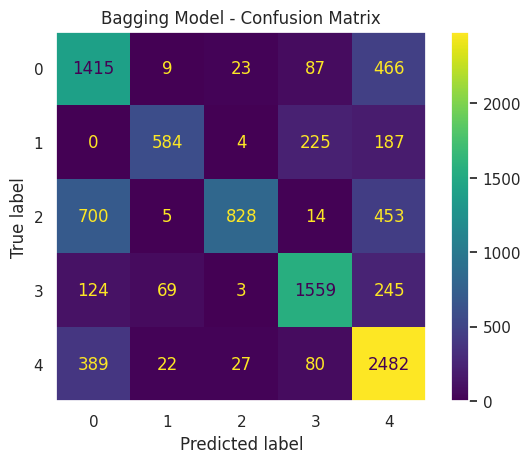

              precision    recall  f1-score   support

           0       0.54      0.71      0.61      2000
           1       0.85      0.58      0.69      1000
           2       0.94      0.41      0.57      2000
           3       0.79      0.78      0.79      2000
           4       0.65      0.83      0.73      3000

    accuracy                           0.69     10000
   macro avg       0.75      0.66      0.68     10000
weighted avg       0.73      0.69      0.68     10000



In [31]:
show_metrics(y_test, y_pred_bagging, bagging_model.classes_, 'Bagging Model - Confusion Matrix')

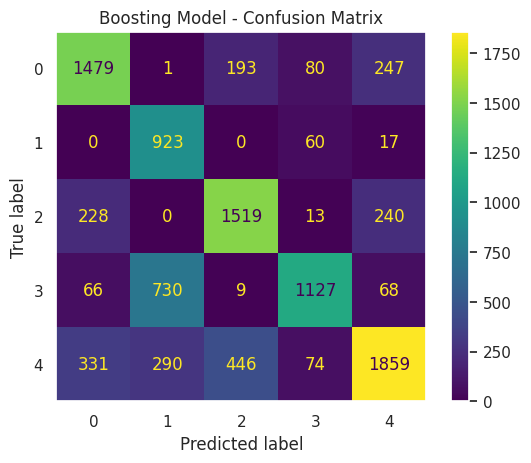

              precision    recall  f1-score   support

           0       0.70      0.74      0.72      2000
           1       0.47      0.92      0.63      1000
           2       0.70      0.76      0.73      2000
           3       0.83      0.56      0.67      2000
           4       0.76      0.62      0.68      3000

    accuracy                           0.69     10000
   macro avg       0.70      0.72      0.69     10000
weighted avg       0.72      0.69      0.69     10000



In [32]:
show_metrics(y_test, y_pred_boosting, boosting_model.classes_, 'Boosting Model - Confusion Matrix')

In [33]:
from sklearn.metrics import accuracy_score, f1_score

In [36]:
df_metrics = pd.DataFrame.from_dict(
    {
        'Baseline': {
            'Accuracy': accuracy_score(y_test, y_pred_base),
            'F1': f1_score(y_test, y_pred_base, average='weighted')
        },
        'Bagging': {
            'Accuracy': accuracy_score(y_test, y_pred_bagging),
            'F1': f1_score(y_test, y_pred_bagging, average='weighted')
        },
        'Boosting': {
            'Accuracy': accuracy_score(y_test, y_pred_boosting),
            'F1': f1_score(y_test, y_pred_boosting, average='weighted')
        }
    }
).T
display(df_metrics)

,Accuracy,F1
Baseline,0.6877,0.682401
Bagging,0.6868,0.681472
Boosting,0.6907,0.692451


When comparing all the three models based on the metrics, more or less all the models are performing similarly. This may be becuase the depth of the tree is 3 and the model is very simple. Even with the ensemble techniques, it is not able to learn variations in the data.  
Precisely, the boosting model has performed slightly better. This is because the boosting model is being trained sequentially where the misclassified data points of the previous model are given more weights. 

---

## Part B - Guessing the Mystery label

In [37]:
from sklearn.decomposition import PCA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.cluster import KMeans

### Principal Component Analysis

In [38]:
pca = PCA(n_components=2)
X_train_pca = pca.fit_transform(X_train)

In [57]:
pca_df = pd.DataFrame(data=X_train_pca, columns=['PC1', 'PC2'])
pca_df['Label'] = pd.Categorical(y_train)

fig = px.scatter(
    pca_df, x='PC1', y='PC2', color='Label',
    color_discrete_sequence=px.colors.qualitative.Safe, title='PCA Plot'   # color_continuous_scale='plasma'
)
fig.update_layout(width=800, height=600)
for label in pca_df['Label'].unique():
    fig.update_traces(marker=dict(size=8), selector=dict(name=str(label)))
fig.show()

#### Linear Discriminant Analysis

In [56]:
lda = LDA(n_components=2)
X_train_lda = lda.fit_transform(X_train, y_train)

In [58]:
lda_df = pd.DataFrame(data=X_train_lda, columns=['x1', 'x2'])
lda_df['Label'] = pd.Categorical(y_train)

fig = px.scatter(
    lda_df, x='x1', y='x2', color='Label',
    color_discrete_sequence=px.colors.qualitative.Safe, title='LDA Plot' 
)
fig.update_layout(width=800, height=600)
for label in lda_df['Label'].unique():
    fig.update_traces(marker=dict(size=8), selector=dict(name=str(label)))
fig.show()

#### K-Means Model

In [61]:
kmeans_model = KMeans(n_clusters=5, random_state=8883828)
kmeans_model.fit(X_train)

KMeans(n_clusters=5, random_state=8883828)

In [62]:
clusters = kmeans_model.predict(X_train)

In [66]:
pca_df['Cluster'] = pd.Categorical(clusters)
fig = px.scatter(
    pca_df, x='PC1', y='PC2', color='Cluster',
    color_discrete_sequence=px.colors.qualitative.Safe, title='PCA Plot with KMeans clusters'
)
fig.update_layout(width=800, height=600)
for label in pca_df['Cluster'].unique():
    fig.update_traces(marker=dict(size=8), selector=dict(name=str(label)))
fig.show()

In [67]:
lda_df['Cluster'] = pd.Categorical(clusters)
fig = px.scatter(
    lda_df, x='x1', y='x2', color='Cluster',
    color_discrete_sequence=px.colors.qualitative.Safe, title='LDA Plot with KMeans clusters'
)
fig.update_layout(width=800, height=600)
for label in lda_df['Cluster'].unique():
    fig.update_traces(marker=dict(size=8), selector=dict(name=str(label)))
fig.show()

In [99]:
cluster_labels = pd.DataFrame({'Cluster': clusters, 'Label': y_train})
label_guesses = cluster_labels.groupby('Cluster')['Label'].value_counts().unstack().idxmax(axis=1).values
print('Guessed Labels:', label_guesses)

Guessed Labels: [3 0 2 2 4]


In [101]:
pca_df.groupby('Cluster')['Label'].value_counts()

Cluster  Label
0        3        6526
         1        5416
         0        2582
         2        1476
         4        1461
1        0        5247
         4        2844
         2         464
         3         235
         1           3
2        2        4408
         4        4179
         0        2850
         3        1655
         1           2
3        2        5634
         4        4053
         0        1280
         3         156
         1           7
4        4        5463
         3        3428
         1         572
         0          41
         2          18
Name: count, dtype: int64

By checking the above combinations, below are the guesses
|Cluster|Label (Guessed)|
|-------|-----|
|0|3|
|1|0|
|2|4|
|3|2|
|4|3|



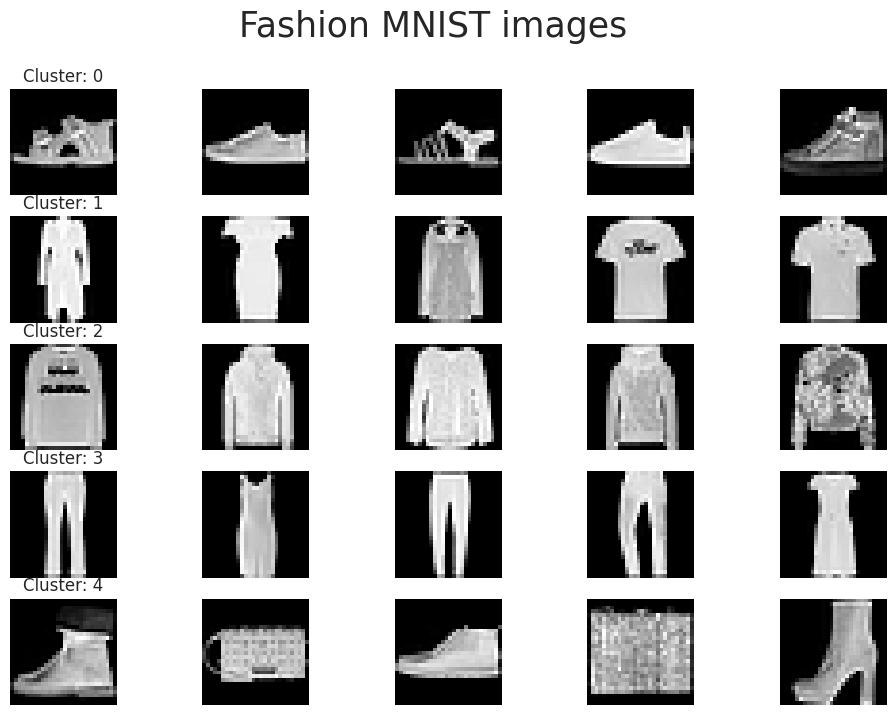

In [113]:
fig, axes = plt.subplots(5, 5, figsize=(12, 8))
for i in range(5):
    axes[i, 0].set_title(f'Cluster: {i}')
    cluster_indices = np.where(clusters == i)[0]
    sample_indices = np.random.choice(cluster_indices, 5, replace=False)

    for j, index in enumerate(sample_indices):
        axes[i, j].imshow(np.array(X_train.iloc[index]).astype('uint8').reshape(28, 28), cmap='gray')
        # plt.imshow(np.array(X_train.iloc[index]).reshape(28, 28), cmap='gray')
        axes[i, j].axis('off')

plt.suptitle('Fashion MNIST images', fontsize=25)
plt.show()


Cluster 0 represents Sandals and Sneakers  
Cluster 1 represents T-shirt/top and Shirts   
Cluster 2 represents Pullover and Coat  
Cluster 3 represents Trousers and Dress  
Cluster 4 represents Ankleboots and Bags

---